### Wine Reviews
Performing K-means clustering on "Wine Reviews" dataset found on Kaggle Datasets (https://www.kaggle.com/zynicide/wine-reviews?rvi=1).
The initial dataset (winemag-data_first150k.csv) has 150,930 rows and 11 headers.
### Headers
- Entry ID
- Country
- Description
- Designation
- Points
- Price
- Province
- Region 1
- Region 2
- Variety
- Winery

In [13]:
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

sb.set()

In [14]:
data = pd.read_csv('winemag-data_first150k.csv')

In [15]:
x, y = data.shape
print("Shape of dataset: rows: {} | columns: {}".format(x, y))
columns = data.columns
print("Headers of dataset: {}".format(columns))

Shape of dataset: rows: 150930 | columns: 11
Headers of dataset: Index(['Unnamed: 0', 'country', 'description', 'designation', 'points',
       'price', 'province', 'region_1', 'region_2', 'variety', 'winery'],
      dtype='object')


Slight data cleaning needs to be done. Not all of the entries have prices or regions and these will be ignored. This dramatically reduces the size of the dataset from 
150k to just over 39k

In [16]:
cleaned_data = data.dropna()

In [17]:
x, y = cleaned_data.shape
print("Shape of dataset: rows: {} | columns: {}".format(x, y))

Shape of dataset: rows: 39241 | columns: 11


In [18]:
cleaned_data.head()

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,variety,winery
0,0,US,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235.0,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz
2,2,US,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90.0,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley
3,3,US,"This spent 20 months in 30% new French oak, an...",Reserve,96,65.0,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi
8,8,US,This re-named vineyard was formerly bottled as...,Silice,95,65.0,Oregon,Chehalem Mountains,Willamette Valley,Pinot Noir,Bergström
9,9,US,The producer sources from two blocks of the vi...,Gap's Crown Vineyard,95,60.0,California,Sonoma Coast,Sonoma,Pinot Noir,Blue Farm


Will be initally testing clusters on price vs points. This is to get a broad understanding of how the score of the wine depends on the price

Text(0, 0.5, 'Wine Price')

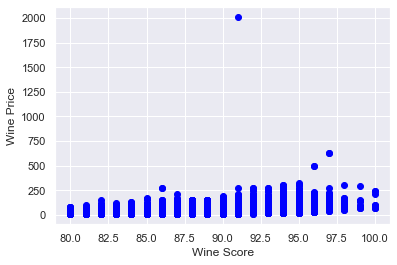

In [22]:
plt.scatter(cleaned_data['points'], cleaned_data['price'], c="blue", marker='o')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")

Initally KMeans setup to arbitrarely choose number of clusters based on visualization

In [24]:
scores_price_ds = cleaned_data[['points', 'price']]

In [26]:
kmeans = KMeans(n_clusters=3, init='k-means++')
kmeans.fit(scores_price_ds)
results = kmeans.predict(scores_price_ds)

Text(0, 0.5, 'Wine Price')

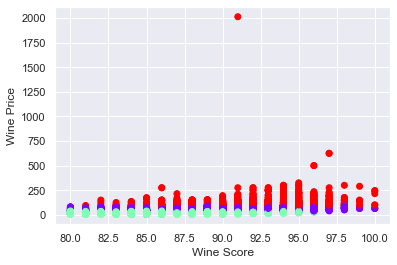

In [27]:
plt.scatter(cleaned_data['points'], cleaned_data['price'], c=results, marker='o', cmap='rainbow')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")

Employing Elbow method to determin number of clusters

In [28]:
inertia = []
for i in range(1,10):
    kmeans = KMeans(n_clusters=i, init='k-means++')
    kmeans.fit(scores_price_ds)
    print(kmeans.inertia_)
    inertia.append(kmeans.inertia_)

28472444.983613975
15438976.927087126
10310290.70447512
6740981.195362726
4346977.93908845
3161272.436075322
2306928.903964722
1909338.713199192
1494339.5426040513


Text(0, 0.5, 'SSE')

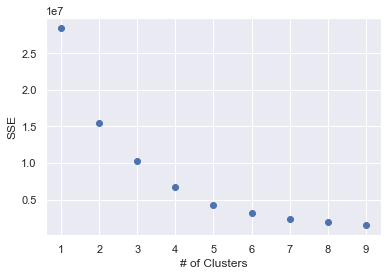

In [29]:
clusters = range(1,10)
plt.scatter(clusters, inertia)
plt.xlabel("# of Clusters")
plt.ylabel("SSE")

In [30]:
kmeans = KMeans(n_clusters=2, init='k-means++')
kmeans.fit(scores_price_ds)
results = kmeans.predict(scores_price_ds)

Text(0, 0.5, 'Wine Price')

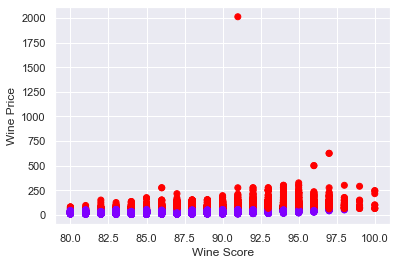

In [31]:
plt.scatter(cleaned_data['points'], cleaned_data['price'], c=results, marker='o', cmap='rainbow')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")

There seem to be several outliers within the dataset when comparing the price to the score. I will go ahead and remove these using the z-score test (any points that are more than 3 STD from the mean)

In [36]:
from scipy.stats import zscore
import numpy as np

z_score = zscore(scores_price_ds)
abs_z_score = np.abs(z_score)
filtered = (abs_z_score < 3).all(axis=1)
filtered_ds = scores_price_ds[filtered]

In [38]:
x1, y1 = scores_price_ds.shape
x, y = filtered_ds.shape
print("Number of outliers removed: {}".format(x1-x))

Number of outliers removed: 621


Text(0, 0.5, 'Wine Price')

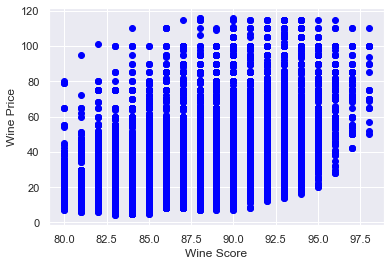

In [41]:
plt.scatter(filtered_ds['points'], filtered_ds['price'], c='blue', marker='o')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")

Determining optimal number of clusters 

In [42]:
inertia = []
for i in range(1, 10):
    kmeans = KMeans(n_clusters=i, init='k-means++')
    kmeans.fit(filtered_ds)
    print("SSE: {}".format(kmeans.inertia_))
    inertia.append(kmeans.inertia_)

SSE: 14177376.123330085
SSE: 5282427.674666061
SSE: 2624475.691719931
SSE: 1659364.3875196774
SSE: 1246150.8280981176
SSE: 950808.8139314473
SSE: 775600.8074171122
SSE: 664628.586668281
SSE: 603801.5428737287


Text(0, 0.5, 'SSE')

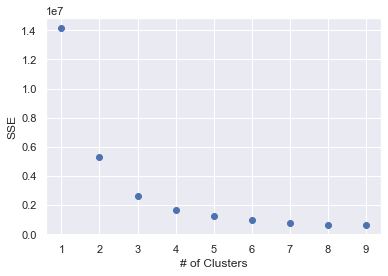

In [43]:
plt.scatter(clusters, inertia)
plt.xlabel("# of Clusters")
plt.ylabel("SSE")

In [51]:
kmeans = KMeans(n_clusters=2, init='k-means++')
kmeans.fit(filtered_ds)
result = kmeans.predict(filtered_ds)

Text(0, 0.5, 'Wine Price')

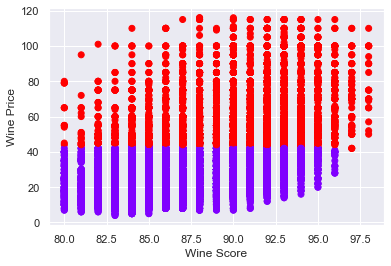

In [53]:
plt.scatter(filtered_ds['points'], filtered_ds['price'], c=result, marker='o', cmap='rainbow')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")

Next we are going to run the experiment in price vs the type of wine to see if there is any correlation